<p style="text-align:center">
    <a href="https://skills.network" target="_blank">
    <img src="https://cf-courses-data.s3.us.cloud-object-storage.appdomain.cloud/assets/logos/SN_web_lightmode.png" width="200" alt="Skills Network Logo">
    </a>
</p>


#  **GridSearchCV: Hyperparameter Tuning in Machine Learning**


Estimated time needed: **15** minutes


## **Objectives**


After completing this lab you will be able to:


* Explain the concept of GridSearchCV
* Identify scenarios where GridSearchCV can be useful
* Use GridSearchCV to perform hyperparameter tuning for machine learning models


## **Introduction to GridSearchCV**


GridSearchCV in Scikit-Learn is a vital tool for hyperparameter tuning, performing an exhaustive search over specified parameter values for an estimator. It systematically evaluates each combination using cross-validation to identify the optimal settings that maximize model performance based on a scoring metric like accuracy or F1-score. Hyperparameter tuning is crucial as it significantly impacts model performance, preventing underfitting or overfitting. GridSearchCV automates this process, ensuring robust generalization on unseen data. It helps data scientists efficiently find the best hyperparameters, saving time and resources while optimizing model performance, making it an essential tool in the machine learning pipeline.

## **Parameters of GridSearchCV**


GridSearchCV has several important parameters:

**Estimator**: The model or pipeline to be optimized. This can be any Scikit-Learn estimator like LogisticRegression(),SVC(), RandomForestClassifier(), etc.

**param_grid**: A dictionary or list of dictionaries with parameter names (as strings) as keys and lists of parameter settings to try as values. Using param_grid, you can specify the hyperparameters for various models to find the optimal combination.

Examples of various models hyperparameters for the param_grid parameter.

* **Logistic Regression**: When tuning a logistic regression model, GridSearchCV can search through different values of C, penalty, and solver to find the best parameters.

```python
    parameters = {'C': [0.01, 0.1, 1],
                'penalty': ['l2'],
                'solver': ['lbfgs']
```

**C**: Inverse of regularization strength; smaller values specify stronger regularization.

**penalty**: Specifies the norm of the penalty; 'l2' is ridge regression.

**solver**: Algorithm to use in the optimization problem.

* **Support Vector Machine**: For SVM, GridSearchCV can explore different kernels, C values, and gamma settings to optimize the model.

```python
    parameters = {'kernel': ['linear', 'rbf', 'poly', 'sigmoid'],
                'C': np.logspace(-3, 3, 5),
                'gamma': np.logspace(-3, 3, 5)}
```

**kernel**: Specifies the kernel type to be used in the algorithm.

**C**: Regularization parameter.

**gamma**: Kernel coefficient.

* **Decision Tree Classifier**: In the case of a decision tree, GridSearchCV can test various criteria, splitters, depths, and other parameters to find the best configuration.

```python
    parameters = {'criterion': ['gini', 'entropy'],
                'splitter': ['best', 'random'],
                'max_depth': [2*n for n in range(1, 10)],
                'max_features': ['auto', 'sqrt'],
                'min_samples_leaf': [1, 2, 4],
                'min_samples_split': [2, 5, 10]}
```

**criterion**: The function to measure the quality of a split.

**splitter**: The strategy used to choose the split at each node.

**max_depth**: The maximum depth of the tree.

**max_features**: The number of features to consider when looking for the best split.

**min_samples_leaf**: The minimum number of samples required to be at a leaf node.

**min_samples_split**: The minimum number of samples required to split an internal node.

* **K-Nearest Neighbors**: For KNN, GridSearchCV can try different numbers of neighbors, algorithms, and power parameters to determine the best model.

```python
    parameters = {'n_neighbors': [1, 2, 3, 4, 5, 6, 7, 8, 9, 10],
                'algorithm': ['auto', 'ball_tree', 'kd_tree', 'brute'],
                'p': [1, 2]}
```

**n_neighbors**: Number of neighbors to use.

**algorithm**: Algorithm used to compute the nearest neighbors.

**p**: Power parameter for the Minkowski metric.

* **Other Parameters**:

**scoring**: A single string or callable to evaluate the predictions on the test set. Common options include accuracy, f1, roc_auc, etc. If none, the estimator's default scorer is used.

**n_jobs**: The number of jobs to run in parallel. -1 means using all processors.

**pre_dispatch**: Controls the number of jobs that get dispatched during parallel execution. It can be an integer or expressions like 2n_jobs, 3n_jobs, etc., to limit the number of jobs dispatched at once.

**refit**: If True, refits the best estimator with the entire dataset. The best estimator is stored in the best_estimator_ attribute. Default is True.

**cv**: Determines the cross-validation splitting strategy. It can be an integer to specify the number of folds, a cross-validation generator, or an iterable. Default is 5-fold cross-validation.

**verbose**: Controls the verbosity level. Higher values indicate more messages. verbose=0 is silent, verbose=1 shows some messages, and verbose=2 shows more messages.

**return_train_score**: If False, the cv_results_ attribute will not include training scores. Default is False.

**error_score**: Value to assign to the score if an error occurs in estimator fitting. np.nan is the default, but it can be set to a specific value.

## **Applications and Advantages of GridSearchCV**


* **Model Selection**: GridSearchCV enables the comparison of multiple models and facilitates the selection of the best-performing one for a given data set.

* **Hyperparameter Tuning**: It automates the process of finding the optimal hyperparameters, which can significantly improve the performance of machine learning models.

* **Pipeline Optimization**: GridSearchCV can be applied to complex pipelines involving multiple preprocessing steps and models to optimize the entire workflow.

* **Cross-Validation**: It incorporates cross-validation in the parameter search process, ensuring that the model's performance is robust and not overfitted to a particular train-test split.

* **Exhaustive Search**: GridSearchCV performs an exhaustive search over the specified parameter grid, ensuring that the best combination of parameters is found.

* **Parallel Execution**: With the n_jobs parameter, it can leverage multiple processors to speed up the search process.

* **Automatic Refit**: By setting refit=True, GridSearchCV automatically refits the model with the best parameters on the entire data set, making it ready for use.

* **Detailed Output**: The cv_results_ attribute provides detailed information about the performance of each parameter combination, including training and validation scores, which helps in understanding the model's behavior.

## **Practical Example**


Let us demonstrate the use of **GridSearchCV** with a practical example using the Iris data set. We will perform a grid search to find the optimal hyperparameters for a support vector classifier (SVC).

**Import necessary libraries**: First, import the essential libraries required for loading the data set, splitting the data, performing GridSearchCV, and evaluating the model.

In [1]:
import numpy as np
import pandas as pd
from sklearn.datasets import load_iris
from sklearn.model_selection import train_test_split, GridSearchCV
from sklearn.svm import SVC
from sklearn.metrics import classification_report
import warnings
# Ignore warnings
warnings.filterwarnings('ignore')

**Load the Iris data set**: The Iris data set is a classic data set in machine learning. Load it using the load_iris function from Scikit-Learn.

In [2]:
iris = load_iris()
X = iris.data
y = iris.target

* X: Features of the Iris dataset (sepal length, sepal width, petal length, petal width).
* y: Target labels representing the three species of Iris (setosa, versicolor, virginica).

**Splitting the data into training and test set**: Divide data set into training and test sets to evaluate how well the model performs on data it has not been trained on.

In [3]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

* test_size=0.2: 20% of the data is used for testing.
* random_state=42: Ensures reproducibility of the random split.

**Define the parameter grid**: Specify a grid of hyperparameters for the SVM model to search over. The grid includes different values for **C**, **gamma**, and **kernel**.

In [4]:
param_grid = {
    'C': [0.1, 1, 10, 100],
    'gamma': [1, 0.1, 0.01, 0.001],
    'kernel': ['linear', 'rbf', 'poly']
}

* **C**: Regularization parameter.
* **gamma**: Kernel coefficient.
* **kernel**: Specifies the type of kernel to be used in the algorithm.

**Initialize the SVC model**: Create an instance of the support vector classifier (SVC).

In [5]:
svc = SVC()

**Initialize GridSearchCV**: Set up the GridSearchCV with the SVC model, the parameter grid, and the desired configuration.

In [6]:
grid_search = GridSearchCV(estimator=svc, param_grid=param_grid, scoring='accuracy', cv=5, n_jobs=-1, verbose=2)

* **estimator**: The model to optimize (SVC).

* **param_grid**: The grid of hyperparameters.

* **scoring='accuracy'**: The metric used to evaluate the model's performance.

* **cv=5**: 5-fold cross-validation.

* **n_jobs=-1**: Use all available processors.

* **verbose=2**: Show detailed output during the search.

**Fit GridSearchCV to the training data**: Perform the grid search on the training data.

In [7]:
grid_search.fit(X_train, y_train)

Fitting 5 folds for each of 48 candidates, totalling 240 fits
[CV] END ......................C=0.1, gamma=1, kernel=linear; total time=   0.0s
[CV] END ......................C=0.1, gamma=1, kernel=linear; total time=   0.0s
[CV] END ......................C=0.1, gamma=1, kernel=linear; total time=   0.0s
[CV] END ......................C=0.1, gamma=1, kernel=linear; total time=   0.0s
[CV] END .........................C=0.1, gamma=1, kernel=rbf; total time=   0.0s
[CV] END .........................C=0.1, gamma=1, kernel=rbf; total time=   0.0s
[CV] END ........................C=0.1, gamma=1, kernel=poly; total time=   0.0s
[CV] END .........................C=0.1, gamma=1, kernel=rbf; total time=   0.0s
[CV] END ........................C=0.1, gamma=1, kernel=poly; total time=   0.0s
[CV] END ........................C=0.1, gamma=1, kernel=poly; total time=   0.0s
[CV] END ........................C=0.1, gamma=1, kernel=poly; total time=   0.0s
[CV] END ......................C=0.1, gamma=1, 

GridSearchCV(cv=5, estimator=SVC(), n_jobs=-1,
             param_grid={'C': [0.1, 1, 10, 100], 'gamma': [1, 0.1, 0.01, 0.001],
                         'kernel': ['linear', 'rbf', 'poly']},
             scoring='accuracy', verbose=2)

**Check the best parameters and estimator**: After fitting, print the best parameters and the best estimator found during the grid search.

In [8]:
print("Best parameters found: ", grid_search.best_params_)
print("Best estimator: ", grid_search.best_estimator_)

Best parameters found:  {'C': 0.1, 'gamma': 0.1, 'kernel': 'poly'}
Best estimator:  SVC(C=0.1, gamma=0.1, kernel='poly')


**Make predictions with the best estimator**: Use the best estimator to make predictions on the test set.

In [9]:
y_pred = grid_search.best_estimator_.predict(X_test)

**Evaluate the performance**: Evaluate the model's performance on the test set using the classification_report function, which provides precision, recall, F1-score, and support for each class.

In [10]:
print(classification_report(y_test, y_pred))

              precision    recall  f1-score   support

           0       1.00      1.00      1.00        10
           1       1.00      1.00      1.00         9
           2       1.00      1.00      1.00        11

    accuracy                           1.00        30
   macro avg       1.00      1.00      1.00        30
weighted avg       1.00      1.00      1.00        30



## **Practice 2**

In [11]:
churn_df = pd.read_csv("ChurnData.csv")
churn_df.head()

,tenure,age,address,income,ed,employ,equip,callcard,wireless,longmon,...,pager,internet,callwait,confer,ebill,loglong,logtoll,lninc,custcat,churn
0,11.0,33.0,7.0,136.0,5.0,5.0,0.0,1.0,1.0,4.40,...,1.0,0.0,1.0,1.0,0.0,1.482,3.033,4.913,4.0,1.0
1,33.0,33.0,12.0,33.0,2.0,0.0,0.0,0.0,0.0,9.45,...,0.0,0.0,0.0,0.0,0.0,2.246,3.240,3.497,1.0,1.0
2,23.0,30.0,9.0,30.0,1.0,2.0,0.0,0.0,0.0,6.30,...,0.0,0.0,0.0,1.0,0.0,1.841,3.240,3.401,3.0,0.0
3,38.0,35.0,5.0,76.0,2.0,10.0,1.0,1.0,1.0,6.05,...,1.0,1.0,1.0,1.0,1.0,1.800,3.807,4.331,4.0,0.0
4,7.0,35.0,14.0,80.0,2.0,15.0,0.0,1.0,0.0,7.10,...,0.0,0.0,1.0,1.0,0.0,1.960,3.091,4.382,3.0,0.0


In [12]:
churn_df = churn_df[['tenure', 'age', 'address', 'income', 'ed', 'employ', 'equip',   'callcard', 'wireless','churn']]
churn_df['churn'] = churn_df['churn'].astype('int')
churn_df.head()

,tenure,age,address,income,ed,employ,equip,callcard,wireless,churn
0,11.0,33.0,7.0,136.0,5.0,5.0,0.0,1.0,1.0,1
1,33.0,33.0,12.0,33.0,2.0,0.0,0.0,0.0,0.0,1
2,23.0,30.0,9.0,30.0,1.0,2.0,0.0,0.0,0.0,0
3,38.0,35.0,5.0,76.0,2.0,10.0,1.0,1.0,1.0,0
4,7.0,35.0,14.0,80.0,2.0,15.0,0.0,1.0,0.0,0


In [14]:
X = np.asarray(churn_df[['tenure', 'age', 'address', 'income', 'ed', 'employ', 'equip']])
y = np.asarray(churn_df['churn'])

In [16]:
from sklearn import preprocessing
X = preprocessing.StandardScaler().fit(X).transform(X)

In [17]:
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split( X, y, test_size=0.2, random_state=4)

Testing with 1 cross-validation splits...
Fitting 1 folds for each of 6000 candidates, totalling 6000 fits
[CV] END ...................C=0.0001, solver=newton-cholesky; total time=   0.0s
[CV] END .........................C=0.0001, solver=liblinear; total time=   0.0s
[CV] END ..............................C=0.0001, solver=saga; total time=   0.0s
[CV] END .............................C=0.0001, solver=lbfgs; total time=   0.0s
[CV] END .........................C=0.0002, solver=newton-cg; total time=   0.0s
[CV] END ...................C=0.0002, solver=newton-cholesky; total time=   0.0s
[CV] END ...............................C=0.0002, solver=sag; total time=   0.0s
[CV] END ..............................C=0.0002, solver=saga; total time=   0.0s
[CV] END .............C=0.00030000000000000003, solver=lbfgs; total time=   0.0s
[CV] END .........C=0.00030000000000000003, solver=newton-cg; total time=   0.0s
[CV] END .............................C=0.0002, solver=lbfgs; total time=   0.0s
[C

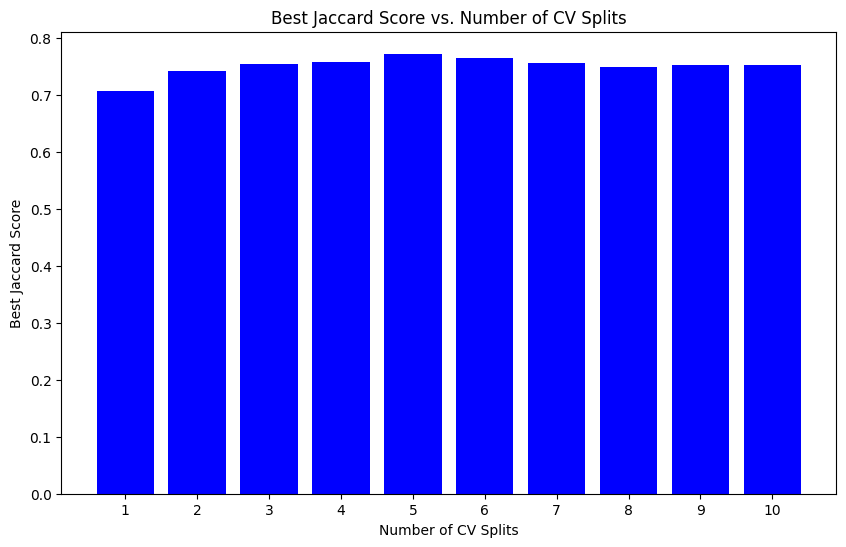

In [44]:
import matplotlib.pyplot as plt
from sklearn.model_selection import GridSearchCV
from sklearn.metrics import make_scorer, log_loss, jaccard_score
from sklearn.linear_model import LogisticRegression
from sklearn.model_selection import ShuffleSplit
import numpy as np

# Define the logistic regression model
LR = LogisticRegression()

# Define the parameter grid
param_grid = {
    'C': np.linspace(0.0001, 0.1, 1000),
    'solver': ['lbfgs', 'liblinear', 'newton-cg', 'newton-cholesky', 'sag', 'saga']
}

# Create custom scorer
scorers = {
    'jaccard_score': make_scorer(jaccard_score, pos_label=0)
}

# Initialize variables to track the best results
best_j_score_overall = 0
best_model_overall = None
best_params_overall = None
best_cv = None

# List to store the best jaccard scores for each split
jaccard_scores = []

# Loop over cv splits from 1 to 10
for n_splits in range(1, 11):
    print(f"Testing with {n_splits} cross-validation splits...")
    
    # Define the ShuffleSplit cross-validator
    cv = ShuffleSplit(test_size=0.20, n_splits=n_splits, random_state=4)
    
    # GridSearchCV with custom scoring
    grid_search = GridSearchCV(estimator=LR, param_grid=param_grid, scoring=scorers, refit='jaccard_score', cv=cv, verbose=2, n_jobs=-1)
    
    # Fit the model
    grid_search.fit(X, y)
    
    # Get the best Jaccard score
    best_j_score = grid_search.best_score_
    jaccard_scores.append(best_j_score)  # Store the best Jaccard score
    
    # Track the overall best model
    if best_j_score > best_j_score_overall:
        best_j_score_overall = best_j_score
        best_model_overall = grid_search.best_estimator_
        best_params_overall = grid_search.best_params_
        best_cv = n_splits

# Evaluate the best model on the test set
yhat_prob = best_model_overall.predict_proba(X_test)
yhat = best_model_overall.predict(X_test)
test_log_loss = log_loss(y_test, yhat_prob)
test_j_score = jaccard_score(y_test, yhat, pos_label=0)

print("BEST ONE")
print(f"Best CV Splits: {best_cv}")
print("C=", round(best_params_overall['C'], 6), ", solver=", best_params_overall['solver'], 
      ", log_loss=", round(test_log_loss, 6), ", j_score=", round(test_j_score, 6))

# Plot the bar plot of best Jaccard scores for each split
plt.figure(figsize=(10, 6))
plt.bar(range(1, 11), jaccard_scores, color='blue')
plt.xlabel('Number of CV Splits')
plt.ylabel('Best Jaccard Score')
plt.title('Best Jaccard Score vs. Number of CV Splits')
plt.xticks(range(1, 11))
plt.show()


## **Key Points**


* GridSearchCV conducts a thorough exploration across a defined parameter grid.
* Parameters include the estimator to optimize, parameter grid, scoring method, number of jobs for parallel execution, cross-validation strategy, and verbosity.
* Practical example demonstrated using GridSearchCV to find the optimal parameters for an SVC model on the Iris data set.
* GridSearchCV helps in selecting the best model by evaluating multiple combinations of hyperparameters.

## **Summary**


In this reading, you learned about GridSearchCV, a powerful tool for hyperparameter tuning in Scikit-Learn. You explored its parameters and saw a practical example using the Iris data set. By leveraging GridSearchCV, you can systematically and efficiently find the best hyperparameters for your machine learning models, leading to improved performance.

## **Author(s)**

<a href="https://www.linkedin.com/in/pratiksha-verma-6487561b1/" target="_blank">Pratiksha Verma</a>


## **Other Contributors**

Malika Singla, Lakshmi Holla